In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
import copy
import time
import numpy as np
import tabulate
sys.path.append(os.path.join(os.path.abspath(""), ".."))

import matplotlib.pyplot as plt

In [114]:
from app.utils import ImageWrapper
from app.custom import RemoveBusBars, Orient, BusbarMask
from app.transforms import FFT, IFFT, CreateOnesMask, PCA, DownsampleBlur
from app.filters import *
from app.imager import ImageLoader, DefectViewer, Show, Exposure

from app.models import Classifier
from sklearn.linear_model import LogisticRegression

In [4]:
# Seed used in show to show the same images when num_images option is set
seed = 1234

# Utility function for plotting during this EDA:
def plot_10(in_imgs):
    fig, axs = plt.subplots(2,5, figsize=(15, 6))
    fig.subplots_adjust(hspace = .5, wspace=.001)
    axs = axs.ravel()
    for i in range(10):
        axs[i].imshow(in_imgs[i], cmap='Greys_r')
        axs[i].set_title(f'{i}')

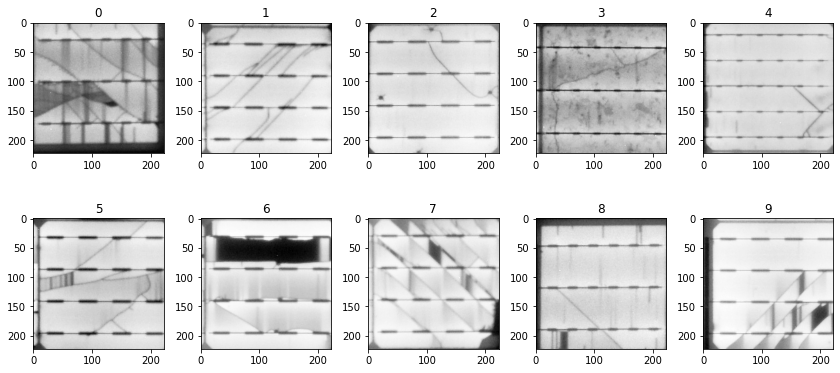

In [104]:
# Load 100 examples and name the category for it. Category is like a title for images
n_samples = 10
closed = (DefectViewer() << (ImageLoader(defect_class='Closed') << n_samples))
closed.category = 'Closed'
#_ = Show(num_images=10, seed=seed) << (closed)
plot_10(closed.images)

## EDA

### Description 

Isolated cracks are at their simplest thin dark likes which represent fractures in the cell wafer material. The shape of the crack is determined by the way the crack was created, and also the underlying properties of the wafer. For instance, if the wafer is multicrystalline, the cracks are generally lines which propagate in all directions, and are typically not smooth lines, since there is no underlying crystallographic plane to 'guide' the crack. 

Cracks in monocrystalline wafers are generally 'straighter', smoother lines which tend to propagate along diagonals in the wafer, due to the way that wafers are sliced along the < 1 0 0 > plane. 

Unlike isolated and resistive cracks, these cracks are characterised by the rack line only, and do not cause any isolated dark regions (isolated) or gradients (resistive) which emanate adjacent to the crack line.

Therefore we need to design filters to extract dark thin lines from the image. 

### Potential Approach

- Blur image and apply a filter such as the Sato, Frangi or Meijering filter to extract thin tube/vessel like structures. We also try a Farid edge detector. 
- Threshold our the crack lines 
- Remove any horizontal lines such as busbars which may be present. 

### Vesselness filters

IN the following blocks we apply different vesselness filters with varying sigma's. Due to the different intensities of the output, we stretch the output values to 0-1. 

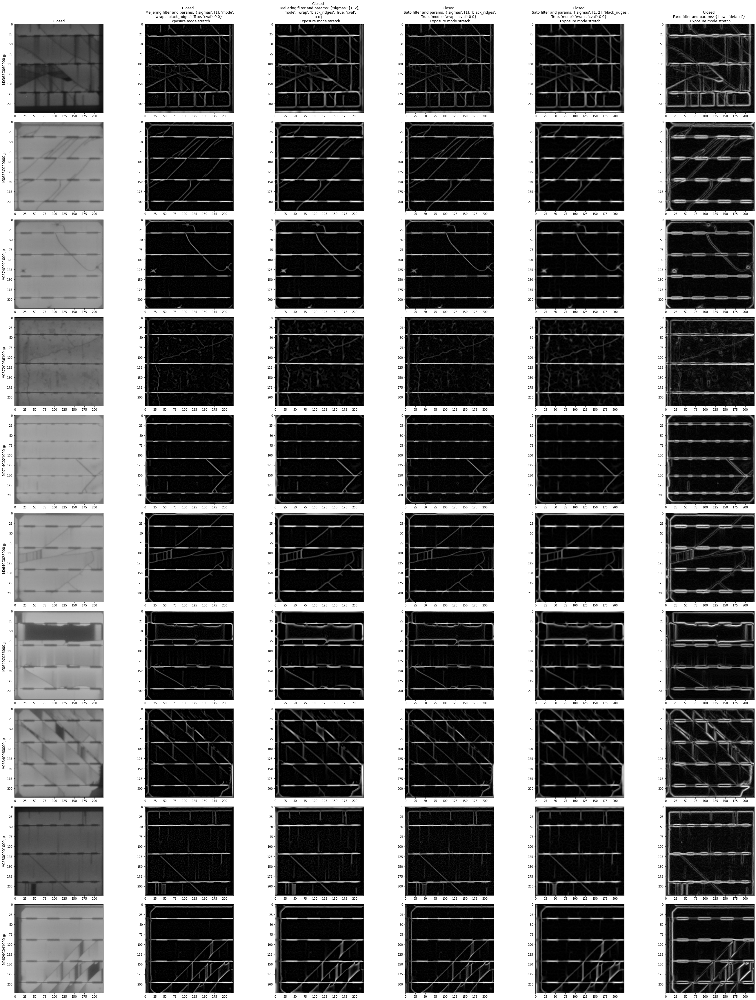

In [131]:
## Test different vesselness filters - sigma = 1,2,3 (note Farid is fixed for comparison)

_, meijering_1 = Exposure('stretch') << (Meijering(sigmas=[1]) <<  closed)
_, sato_1 = Exposure('stretch') <<(Sato(sigmas=[1]) <<  closed)
_, meijering_2 = Exposure('stretch') << (Meijering(sigmas=[1,2]) <<  closed)
_, sato_2 = Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed)
_, farid = Exposure('stretch') << (Farid() <<  closed)
_ = Show(num_images=10, seed=seed) << (closed, meijering_1, meijering_2, sato_1, sato_2, farid)

#### Comments

- The farid filter is highly effetive at detecting the edges, however it is almost picking up too much features and requires further filtering before application.
- The sato and meijiring filters work well filtering the background texture from the cracks, and using sigma of 1 and 2 seems to be superior Using sigma = 1,2 and 3(not shown), and just 1 alone.
- Looking closely, the Sato filter with sigma's 1,2 tends to pick up less background noise than the meijering filter of the same parameters.

We will continue with the Sato filter but first explore the Frangi filter, which allows for a few more parameters to be tuned including:

- alpha: Frangi correction constant that adjusts the filter’s sensitivity to deviation from a plate-like structure. 
- beta: Frangi correction constant that adjusts the filter’s sensitivity to deviation from a blob-like structure.
- gamma: Frangi correction constant that adjusts the filter’s sensitivity to areas of high variance/texture/structure.

[source](https://scikit-image.org/docs/stable/api/skimage.filters.html#skimage.filters.frangi)

For comparison, we also try a Canny filter.

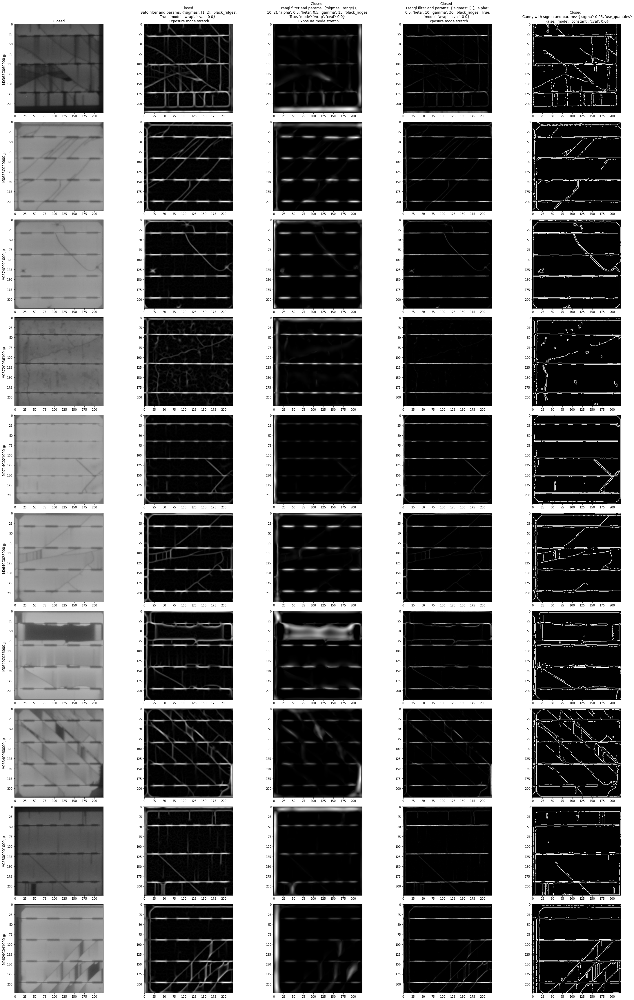

In [160]:
## Test different vesselness filters - sigma = 1,2 

_, sato = Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed)
_, frangi_default = Exposure('stretch') <<(Frangi(sigmas=range(1,10,2)) <<  closed)
_, frangi_1 = Exposure('stretch') <<(Frangi(sigmas=[1], beta=10, gamma=30) <<  closed)
_, canny = (Canny(0.05) <<  closed)
_ = Show(num_images=10, seed=seed) << (closed, sato, frangi_default, frangi_1, canny)

### Evaluation

We find that the sato and meijering filters strike the best balance crack detection, background separation and sensitivity. Despite the additional parameters of the Frangi filter, we were not able to find good parameters which matched the performane of the Sato or Meijering filter. In comparison, the Canny filter required a very small sigma to be sensitive to the thin cracks, however doing so introduced a lot of noise.

### Issues - Horizontal and Vertical Lines

Vertical lines from the cell edges, or front grid interruptions and horizontal lines from the busars are being picked up. In the case of front grid interruptions, the removal of these may help improve performance of distinguishing between these two classes. 

There are two methods which can be trialled:

- FFT filtering the horizontal and vertical magnitudes from the FFT transformed image. 
- Using kernels and morphology functions in OpenCV2. 

#### Fourier Transform

We try a fourier transformed imagge whereby we try the following masks on the transformed magnitude:

- horizontal line - to target vertical frequencies in the image
- vertical line: targets horizontal lines in the image,
- A cross: both vertical and horizontal lines in the image

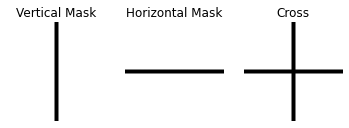

In [278]:
# Function to make masks
def create_mask(half_width, shape, mtype):
    
  # Create a vertical mask
    if mtype == 'vertical':
        in_mask = np.zeros(shape)
        midpoint = in_mask.shape[1] // 2
        top_left = (midpoint - half_width, 0)
        bottom_right = (midpoint + half_width, shape[0])
        cv2.rectangle(in_mask, top_left, bottom_right, (255, 255, 255), -1)[0]
        in_mask = in_mask / 255
        
  # Create a horizontal mask
    if mtype == 'horizontal':
        in_mask = np.zeros(shape)
        midpoint = in_mask.shape[0] // 2
        top_left = (0, midpoint - half_width)
        bottom_right = (shape[1], midpoint + half_width)
        cv2.rectangle(in_mask, top_left, bottom_right, (255, 255, 255), -1)[0]
        in_mask = in_mask / 255
        
    return in_mask

# Make masks
vertical = 1 - create_mask(4, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(4, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0

# Plot
_, axes = plt.subplots(nrows=1, ncols=3)
axes[0].imshow(vertical, cmap='gray')
axes[0].set_axis_off()
axes[0].set_title('Vertical Mask')
axes[1].imshow(horizontal, cmap='gray')
axes[1].set_axis_off()
_ = axes[1].set_title('Horizontal Mask')
axes[2].imshow(cross, cmap='gray')
axes[2].set_axis_off()
_ = axes[2].set_title('Cross')

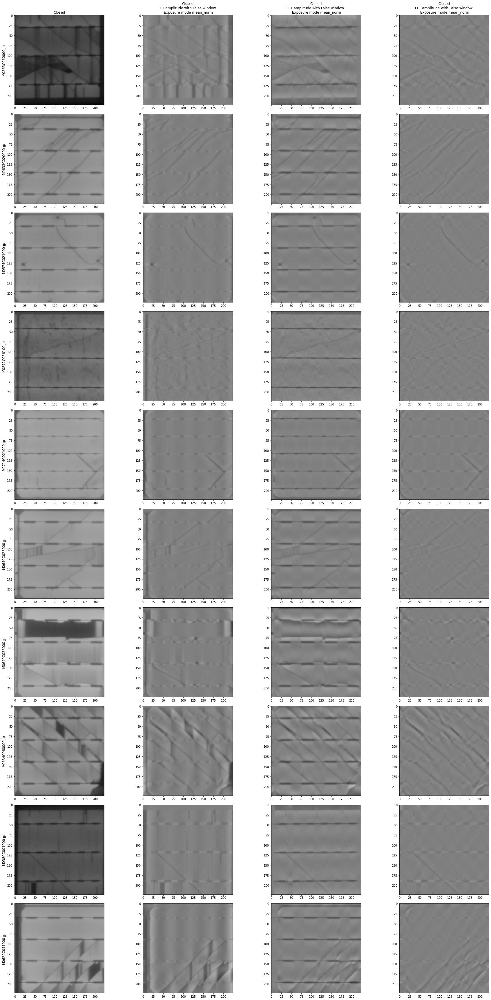

In [280]:
from app.transforms import maskedFFT

_, vertical_ = (Exposure('mean_norm') << (maskedFFT(mask=vertical, window=False) << closed))
_, horizontal_ = (Exposure('mean_norm') <<(maskedFFT(mask=horizontal, window=False) << closed))
_, cross_ = (Exposure('mean_norm') << (maskedFFT(mask=cross, window=False) << closed))
_ = Show(num_images=10, seed=seed) << (closed, vertical_, horizontal_, cross_)

The series of filters applied to the fourier magnitude have done a reasonable job of removing horizontal and vertical lines from the images. 

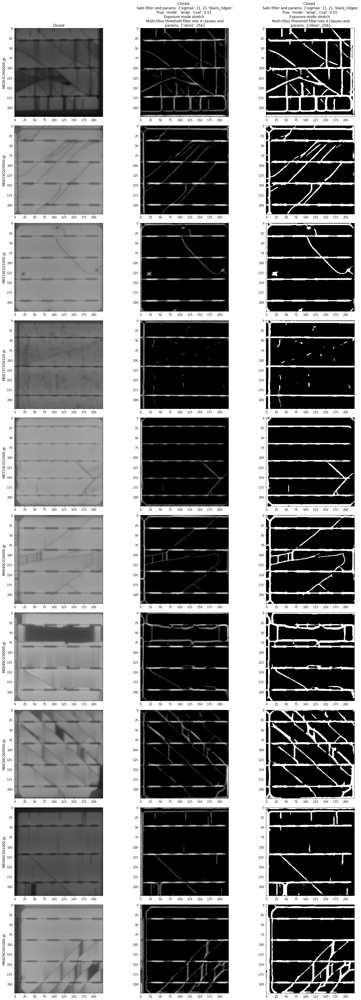

In [282]:
_, Thresholded_1 = Threshold_Multiotsu(n_classes=4, threshold=1, digitize=False) << (Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed))
_, Thresholded_2 = Threshold_Multiotsu(n_classes=4, threshold=2) << (Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed))

_ = Show(num_images=10, seed=seed) << (closed, Thresholded_1, Thresholded_2)

## Putting it all together

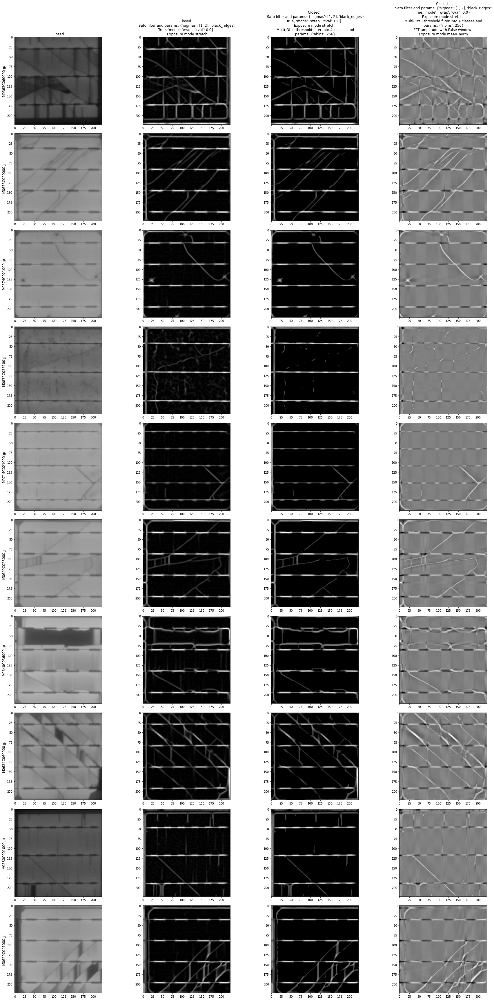

In [309]:
vertical = 1 - create_mask(3, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(3, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0

_, sato_stretched =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
_, sato_thresholded = (Threshold_Multiotsu(n_classes=4, threshold=1, digitize=False)) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
_, sato_thresholded_fft = (Exposure('mean_norm') << (maskedFFT(mask=cross, window=False) \
                                << (Threshold_Multiotsu(n_classes=4, threshold=1, digitize=False) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed)))))



_ = Show(num_images=10, seed=seed) << (closed, sato_stretched, sato_thresholded, sato_thresholded_fft)

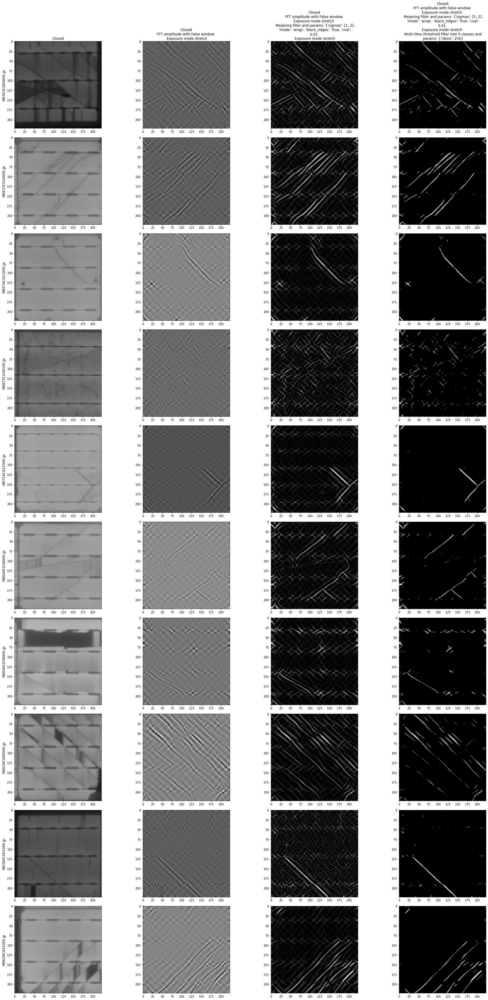

In [415]:
vertical = 1 - create_mask(10, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(10, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0

maskedfft = (Exposure('stretch') << (maskedFFT(mask=cross, window=False) << closed))
sato_maskedfft = Exposure('stretch') << (Meijering(sigmas=[1,2]) << maskedfft)
thresholded_sato_maskedfft = (Threshold_Multiotsu(n_classes=4, threshold=2, digitize=False) << sato_maskedfft)

_ = Show(num_images=10, seed=seed) << (closed, maskedfft[1], sato_maskedfft[1], thresholded_sato_maskedfft[1])

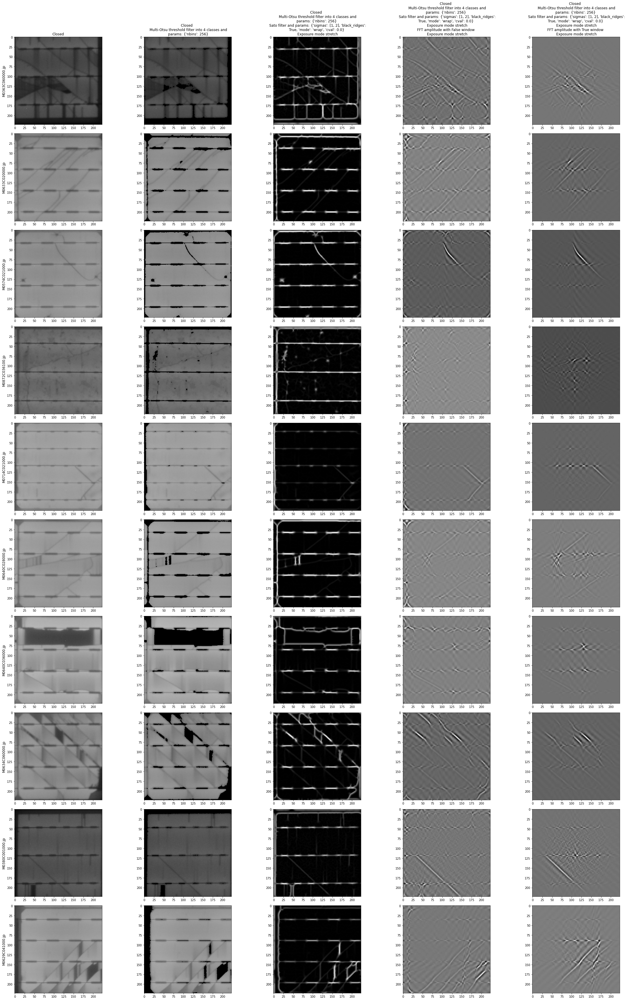

In [416]:
# Create masak
vertical = 1 - create_mask(10, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(10, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0

# Apply threshold
thresholded = (Threshold_Multiotsu(n_classes=4, threshold=1, digitize=False) << closed)
# Apply sato filter and stretch exposure
sato_thresholded = Exposure('stretch') << (Sato(sigmas=[1,2]) << thresholded)
# Apply cross mask top the inverse FFT 
maskedfft_sato_thresholded = (Exposure('stretch') << (maskedFFT(mask=cross, window=False) << sato_thresholded))
maskedfft_sato_thresholded_window = (Exposure('stretch') << (maskedFFT(mask=cross, window=True) << sato_thresholded))

_ = Show(num_images=10, seed=seed) << (closed, thresholded[1],  sato_thresholded[1], maskedfft_sato_thresholded[1], maskedfft_sato_thresholded_window[1])

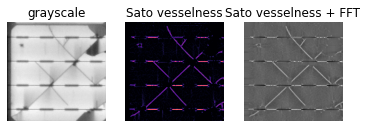

In [370]:
from scipy import ndimage as ndi
from skimage import color, data, filters, graph, measure, morphology

t0, t1, t2 = filters.threshold_multiotsu(test_img, classes=4)
mask = (test_img > t1)
vessels = filters.sato(test_img, sigmas=range(1, 2)) * mask

w = 10
mask = create_mask(w, vessels.shape, 'vertical')
mask = np.max(mask) - create_mask(w, vessels.shape, 'vertical')
masked_img = mask_fft(vessels, cross)

_, axes = plt.subplots(nrows=1, ncols=3)
axes[0].imshow(test_img, cmap='gray')
axes[0].set_axis_off()
axes[0].set_title('grayscale')
axes[1].imshow(vessels, cmap='magma')
axes[1].set_axis_off()
_ = axes[1].set_title('Sato vesselness')
axes[2].imshow(masked_img, cmap='gray')
axes[2].set_axis_off()
_ = axes[2].set_title('Sato vesselness + FFT')

In [74]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

from scipy.ndimage import convolve
from scipy import signal

# Display the fft and the image
def display_fft(in_img, title, log=False, fixed_range=False):
    
    # fourier image
    [ydim, xdim] = in_img.shape
    win = np.outer(np.hanning(ydim), np.hanning(xdim))
    win = win/np.mean(win)

    # fourier image
    F = np.fft.fftshift(np.fft.fft2(in_img*win))
    Fmag = np.abs(F)
    Fmag[Fmag < 0.01] = 0.01

    # Display results
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

    # Display image
    if fixed_range:
        axes[0].imshow(in_img, vmin=0, vmax=1, cmap=plt.cm.gray)
    else:
        axes[0].imshow(in_img, cmap=plt.cm.gray)
        axes[0].set_axis_off()
        axes[0].set_title('Input Image')

    if log:
        axes[1].imshow(np.log(Fmag), cmap=plt.cm.gray)
    else:
        axes[1].imshow(Fmag, cmap=plt.cm.gray)
        axes[1].set_axis_off()
        axes[1].set_title('Fourier Magnitude')

    plt.suptitle(f'{title}')
    plt.show()  

# Create a radial mask
def create_mask(in_rad, shape, mtype):
    
  # Create a vertical mask
    if mtype == 'vertical':
        in_mask = np.zeros(shape)
        midpoint = in_mask.shape[1] // 2
        top_left = (midpoint-in_rad, 0)
        bottom_right = (midpoint+in_rad, shape[0])
        cv2.rectangle(in_mask, top_left, bottom_right, (255, 255, 255), -1)[0]
        in_mask = in_mask / 255        
    
  # create circle mask
    elif mytpe == 'circle':
        in_mask = np.zeros(shape)
        cy = in_mask.shape[0] // 2
        cx = in_mask.shape[1] // 2
        cv2.circle(in_mask, (cx,cy), in_rad, (255, 255, 255), -1)[0]
        in_mask = in_mask / 255

  # blur the mask
    mask2 = cv2.GaussianBlur(in_mask, (15, 15), 10.5, cv2.BORDER_DEFAULT)

    return mask2

# Apply a mask to the FFT image
def mask_fft(in_img, mask):
            
    F = np.fft.fftshift(np.fft.fft2(in_img))
    Fmag = np.abs(F) * mask

    # the ifft assume the incoming fft is shifted to the center of the image
    combined = np.fft.ifftshift(np.multiply(Fmag, np.exp(1j * np.angle(F))))
    imgCombined = np.real(np.fft.ifft2(combined))

    return imgCombined

# Create a Gaussian of a specific size
def create_2d_gaussian(size=9, std=1.5):

    gaussian_1d = signal.gaussian(size, std=std)
    gaussian_2d = np.outer(gaussian_1d, gaussian_1d)
    gaussian_2d = gaussian_2d / (gaussian_2d.sum())

    return gaussian_2d

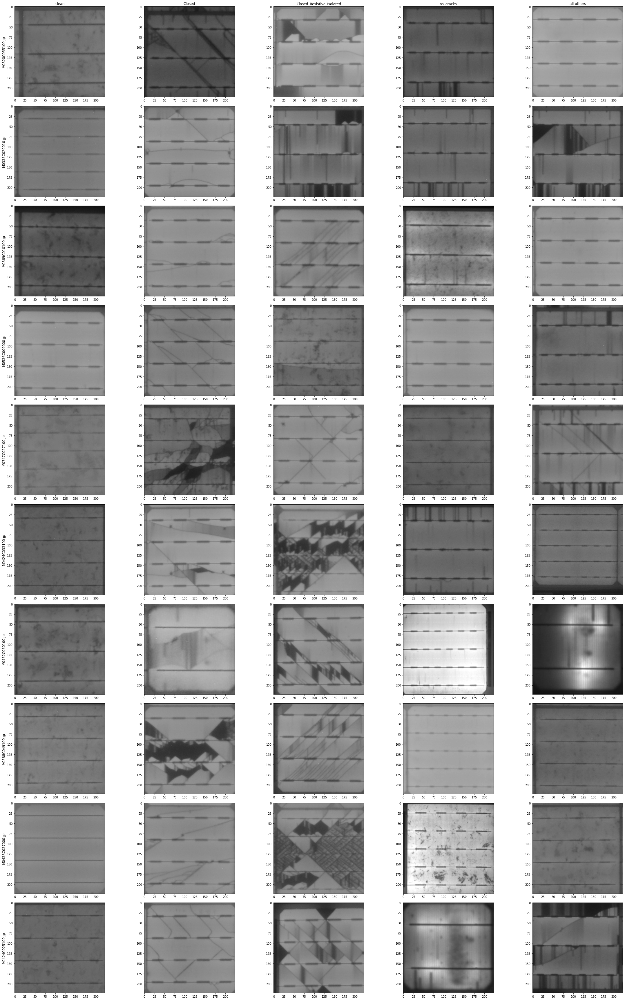

In [422]:
# Load 100 examples and name the category for it. Category is like a title for images
n_samples = 100
closed = (DefectViewer() << (ImageLoader(defect_class='Closed') << n_samples))
all_others = (DefectViewer() << (ImageLoader(defect_class='Closed', is_not=True) << n_samples))
clean = (DefectViewer() << (ImageLoader(defect_class='None') << n_samples))
all_cracks = (DefectViewer() << (ImageLoader(defect_class=['Closed', 'Isolated', 'Resistive']) << n_samples))
no_cracks = (DefectViewer() << (ImageLoader(defect_class=['Closed', 'Isolated', 'Resistive'], is_not=True) << n_samples))

no_cracks.category='no_cracks'
all_cracks.category = 'Closed_Resistive_Isolated'
clean.category = 'clean'
all_others.category='all others'
closed.category = 'Closed'

# NOte all others includes isolated and resistive
_ = Show(num_images=10, seed=seed) << (clean, closed, all_cracks, no_cracks, all_others)

We need to be careful when comparing against the 'all others' defects - since there are example images where defects have been mislabelled or missed. We can see even in the example above, there are cases where 'closed' cracks exist in the 'all_others' category.

The authors of the original dataset lumped all crack classes together for this reason.

In [457]:
image_classes = [clean, closed, all_cracks, no_cracks, all_others]

stacked = []
labels = []

for img in image_classes:
    #flatten images and append
    stacked.append(img.images.reshape(100, img.images.shape[2] * img.images.shape[1]))
    #add labels to seperate list
    [labels.append(img.category) for x in range(5)]
    
all_images = np.vstack(stacked)

In [461]:
#Do a PCA reduction and plot
image_classes = [clean.images, closed.images, all_cracks.images, no_cracks.images, all_others.images]
transformed = PCA(n_components = 2, transpose=False).apply(np.vstack(image_classes))

In [459]:
all_images.shape

(500, 49729)

In [456]:
out = np.vstack(stacked)

In [455]:
out.shape

(500, 49729)

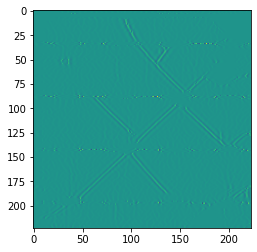

In [99]:
w = 30
mask = create_mask(w, vessels.shape, 'vertical')
mask = np.max(mask) - create_mask(w, vessels.shape, 'vertical')
masked_img = mask_fft(vessels, mask)
plt.imshow(masked_img)

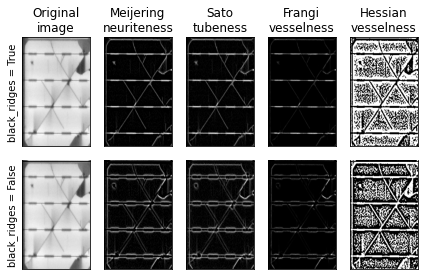

In [35]:
from skimage import data
from skimage import color
from skimage.filters import meijering, sato, frangi, hessian
import matplotlib.pyplot as plt


def identity(image, **kwargs):
    """Return the original image, ignoring any kwargs."""
    return image


image = test_img
cmap = plt.cm.gray

kwargs = {'sigmas': [1], 'mode': 'reflect'}

fig, axes = plt.subplots(2, 5)
for i, black_ridges in enumerate([1, 0]):
    for j, func in enumerate([identity, meijering, sato, frangi, hessian]):
        kwargs['black_ridges'] = black_ridges
        result = func(image, **kwargs)
        axes[i, j].imshow(result, cmap=cmap, aspect='auto')
        if i == 0:
            axes[i, j].set_title(['Original\nimage', 'Meijering\nneuriteness',
                                  'Sato\ntubeness', 'Frangi\nvesselness',
                                  'Hessian\nvesselness'][j])
        if j == 0:
            axes[i, j].set_ylabel('black_ridges = ' + str(bool(black_ridges)))
        axes[i, j].set_xticks([])
        axes[i, j].set_yticks([])

plt.tight_layout()
plt.show()